## Preprocessing datasets

In [1]:
# Dependencies to install in virtual environment
# %pip install pandas matplotlib numpy seaborn plotly geopandas
# Importing required libraries
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import plotly.express as px
import time
import geopandas as gpd
import plotly.graph_objects as go
import matplotlib.dates as mdates
from datetime import time as dtime

In [2]:
# Paths to datasets to fetch fresh data
file_path_2010_2019 =  'https://data.lacity.org/api/views/63jg-8b9z/rows.csv?accessType=DOWNLOAD'
file_path_2020_present = 'https://data.lacity.org/api/views/2nrs-mtv8/rows.csv?accessType=DOWNLOAD'
geojson_path= './server/data/los-angeles.geojson'

In [3]:
# Define the chunk size
chunk_size = 50000

# Start the timer
start_time = time.time()

# Read and concatenate both CSV files into a single DataFrame
df = pd.concat([
    chunk for chunk in pd.read_csv(file_path_2010_2019, chunksize=chunk_size)
] + [
    chunk for chunk in pd.read_csv(file_path_2020_present, chunksize=chunk_size)
], ignore_index=True)

# End the timer
end_time = time.time()

# Calculate the execution time
execution_time = end_time - start_time

# Print the execution time
print(f"Execution Time when fetching fresh data using chunks of size: {chunk_size}: {execution_time:.2f} seconds")

Execution Time  when fetching fresh data using chunks of size: 50000: 187.54 seconds


In [7]:
# Dropping unnecessary features
## The AREA feature has to be two dropped times due to an encoding error in the datasets
df.drop(['DR_NO', 'Date Rptd', 'AREA','AREA ', 'Rpt Dist No', 'Weapon Used Cd', 'Mocodes', 'Status Desc', 'Part 1-2', 'Premis Cd','Premis Desc','Crm Cd 1', 'Crm Cd 2', 'Crm Cd 3', 'Crm Cd 4', 'Cross Street'] , axis=1, inplace=True)

In [8]:
# Define the mapping dictionary to replace descent codes with their full name
descent_mapping = {
    'A': 'Other Asian',
    'B': 'Black',
    'C': 'Chinese',
    'D': 'Cambodian',
    'F': 'Filipino',
    'G': 'Guamanian',
    'H': 'Hispanic/Latin/Mexican',
    'I': 'American Indian/Alaskan Native',
    'J': 'Japanese',
    'K': 'Korean',
    'L': 'Laotian',
    'O': 'Other',
    'P': 'Pacific Islander',
    'S': 'Samoan',
    'U': 'Hawaiian',
    'V': 'Vietnamese',
    'W': 'White',
    'X': 'Unknown',
    'Z': 'Asian Indian'
}

# Replace the values in the 'Vict Descent' column
df['Vict Descent'] = df['Vict Descent'].replace(descent_mapping)

In [9]:
# Function to convert integer (times) to datetime
def int_to_time(integer):
    # Assuming integer represents time in HHMM format
    hour = integer // 100
    minute = integer % 100
    return dtime(hour, minute)

In [10]:
# Creating columns to represent the date of a crime and the time of a crime
df['DATE OCC'] = pd.to_datetime(df['DATE OCC'], format='%m/%d/%Y %I:%M:%S %p')
df['TIME OCC'] = df['TIME OCC'].apply(int_to_time)

In [11]:
# Combining date and time into a singular datetime column
df['DATETIME OCC'] = df['DATE OCC'] + pd.to_timedelta(df['TIME OCC'].astype(str))

# Using the datetime as the index
df.set_index('DATETIME OCC', inplace = True)

# Dropping the date and time columns
df.drop(['TIME OCC', 'DATE OCC'] , axis=1, inplace=True)

#### Keep relevant/frequent crimes in the last 15 years.
Note: As mentioned on the intermediary presentations, we operate under the assumption that infrequent are probabilistically unlikely. Therefore analyzing whether a policy affects them is not useful. <br>

**Step 1:** <br>
To do this, we first ensure that the data is encoded correctly. We can do this by relating the description of crime codes to the crime codes themselves. <br>
(note: Crime Cd is used as it should encode the most important crime, so Crime cd =/= Crm Cd 1 in every instance)

**Step 2:** <br>
Manually check how often the Xth crime occurs to gauge frequency. <br>
Determine a threshold for how frequent a crime has to have occurred in the last 15 years for it to be relevant (>5% of the time).

**Step 3:** <br>
Filter the dataset to remove any crime that did not occur more frequently than the set threshold.

In [12]:
# Step 1:
# Count the amount of times certain crimes have happened over the last 15 years
# Make sure the both fields (Crm Cd & Crm Cd Desc) have the same value to ensure data integrity

# Get the frequency of crime descriptions
crime_code_desc_freq = df['Crm Cd Desc'].value_counts()

# Get the frequency of crime codes
crime_code_freq = df['Crm Cd'].value_counts()

# Initialize a flag to indicate if at least one count does not match
count_match_flag = True

# Iterate over each unique crime description
for desc, desc_count in crime_code_desc_freq.items():
    # Get the count of the corresponding crime code
    code_count = crime_code_freq[df[df['Crm Cd Desc'] == desc]['Crm Cd'].iloc[0]]
    
    # Check if the counts match
    if desc_count != code_count:
        count_match_flag = False
        print(f"Counts for '{desc}' do not match: {desc_count} (desc) vs {code_count} (code)")

# Check if any counts did not match and print the result
if count_match_flag:
    print("Counts match for all crime descriptions.")
else:
    print("At least one count does not match for a crime description.")


Counts match for all crime descriptions.


In [13]:
# Step 2:
# Manually check how frequent the 30th most frequent crime occurs
print(f'Amount of occurences of the crime {crime_code_desc_freq.index[30]}: {crime_code_desc_freq.iloc[30]}')

Amount of occurences of the crime RAPE, FORCIBLE: 14529


In [14]:
# Determine a threshold for frequency
#  Calculate Total Occurrences of the Most Common Crime
total_occurrences_most_common = crime_code_desc_freq.iloc[0]

# Calculate 5% Threshold
one_percent_threshold = total_occurrences_most_common * 0.05

# Create an empty Series to store significant crimes
significant_crimes = pd.Series(dtype=int)

# Identify Significant Frequencies
for crime_type, occurrences in crime_code_desc_freq.items():
    if occurrences >= one_percent_threshold:
        # Add the crime type and its count to the significant crimes Series
        significant_crimes[crime_type] = occurrences

# Display the Series containing significant crimes
print(significant_crimes)
print(len(significant_crimes))

BATTERY - SIMPLE ASSAULT                                    264356
VEHICLE - STOLEN                                            260162
BURGLARY FROM VEHICLE                                       219732
BURGLARY                                                    204784
THEFT PLAIN - PETTY ($950 & UNDER)                          197512
THEFT OF IDENTITY                                           187700
VANDALISM - FELONY ($400 & OVER, ALL CHURCH VANDALISMS)     166012
INTIMATE PARTNER - SIMPLE ASSAULT                           160836
ASSAULT WITH DEADLY WEAPON, AGGRAVATED ASSAULT              145417
THEFT FROM MOTOR VEHICLE - PETTY ($950 & UNDER)             124551
ROBBERY                                                     115548
VANDALISM - MISDEAMEANOR ($399 OR UNDER)                    114514
THEFT-GRAND ($950.01 & OVER)EXCPT,GUNS,FOWL,LIVESTK,PROD    105888
CRIMINAL THREATS - NO WEAPON DISPLAYED                       75644
SHOPLIFTING - PETTY THEFT ($950 & UNDER)                     7

In [15]:
# Extract the crime descriptions from the index of the significant crimes Series
significant_crime_descriptions = significant_crimes.index

# Filter the DataFrame based on crime descriptions to obtain only relevant crimes
df_filtered = df[df['Crm Cd Desc'].isin(significant_crime_descriptions)]

# Display the head of the filtered DataFrame
df_filtered.head(1)


,AREA NAME,Crm Cd,Crm Cd Desc,Vict Age,Vict Sex,Vict Descent,Weapon Desc,Status,LOCATION,LAT,LON
DATETIME OCC,,,,,,,,,,,
2010-02-20 13:50:00,Newton,900,VIOLATION OF COURT ORDER,48,M,Hispanic/Latin/Mexican,NaN,AA,300 E GAGE AV,33.9825,-118.2695


Note: We do notice that some crimes, such as violation of court orders, appear to be victimless crimes, but may in fact have victims. This may happen when the offender violates a restraining order or property order.

In [16]:
# Filter out typos in the Sex of the victims (- and H) as these can not be mapped to any of the encodings (F/M/X) without making assumptions
# This removes a total of 154 instances from the dataframe
df_filtered = df_filtered[~df_filtered['Vict Sex'].isin(['H', '-'])]

# N is assumed to be a typo for M
df_filtered['Vict Sex'] = df_filtered['Vict Sex'].replace('N', 'M')

In [17]:
# 489 instances in total contain ages smaller than 0, due to the varying/contradictory nature of the crimes w.r.t. the ages, and the small number of instances, these were filtered
df_filtered = df_filtered[df_filtered['Vict Age'] >= 0]

# Over 400K of the instances the ages are equal to 0. We filter out all cases where we know there are no victims. We do this by examining all possible null values that could be given to the victim features
# and remove any combination that has one those null values for all three features 
df_filtered = df_filtered[
    ~((df_filtered['Vict Age'] == 0) & 
    ((df_filtered['Vict Sex'].isna()) | (df_filtered['Vict Sex'] == 'X')) & 
    ((df_filtered['Vict Descent'].isna()) | (df_filtered['Vict Descent'] == 'Unknown')))
]

In [18]:
# For the remaining +100K instances where the age is 0, we have no good reason to filter these out. We assume these are miscodings and since this is about 5% of our data we make
# the executive decision to remove these instances.
df_filtered = df_filtered[df_filtered['Vict Age'] > 0]

In [19]:
# Since only 2K instances have no longtitude and latitude we delete this without worrying about the integrity of the conclusions we take from this data
df_filtered = df_filtered[~((df_filtered['LON'] == 0) & (df_filtered['LAT'] == 0))]

In [20]:
# Sorting the dataframe by date
df_sorted = df_filtered.sort_index()

# Observe a sample of the dataframe
df_sorted.head(1)

,AREA NAME,Crm Cd,Crm Cd Desc,Vict Age,Vict Sex,Vict Descent,Weapon Desc,Status,LOCATION,LAT,LON
DATETIME OCC,,,,,,,,,,,
2010-01-01 00:01:00,Hollenbeck,354,THEFT OF IDENTITY,76,M,Hispanic/Latin/Mexican,NaN,IC,4000 N MISSION RD,34.0778,-118.1938


In [21]:
# Saving the combined, filtered & sorted dataframe to a new csv
df_sorted.to_csv('./server/data/Crime_Data_20_Year_Analysis.csv')

## Exploring the data

### Setting sns style

In [22]:
# Set the style and palette
sns.set_style("darkgrid")  # Change the style to darkgrid
sns.set_palette("colorblind")  # Change the color palette

### Temporal Analysis <br>
**Monthly trends**

In [23]:
# Filter data for the year 2020
df_2020 = df_sorted[df_sorted.index.year == 2020]

# Filter data for the year 2021
df_2021 = df_sorted[df_sorted.index.year == 2021]

# Group by month and count occurrences for 2020 data
monthly_counts_2020 = df_2020.groupby(pd.Grouper(freq='ME')).size()

# Group by month and count occurrences for 2021 data
monthly_counts_2021 = df_2021.groupby(pd.Grouper(freq='ME')).size()

# Reset index to access month as a column
monthly_counts_2020 = monthly_counts_2020.reset_index()
monthly_counts_2021 = monthly_counts_2021.reset_index()

# Rename columns for 2020 data
monthly_counts_2020.columns = ['Month', 'Number of Crimes 2020']

# Rename columns for 2021 data
monthly_counts_2021.columns = ['Month', 'Number of Crimes 2021']

# Format the 'Month' column to show only the month and year (e.g., "Jan 2020")
monthly_counts_2020['Month'] = monthly_counts_2020['Month'].dt.strftime('%b')
monthly_counts_2021['Month'] = monthly_counts_2021['Month'].dt.strftime('%b')


# Merge the dataframes on 'Month'
merged_df = pd.merge(monthly_counts_2020, monthly_counts_2021, on='Month', how='outer')


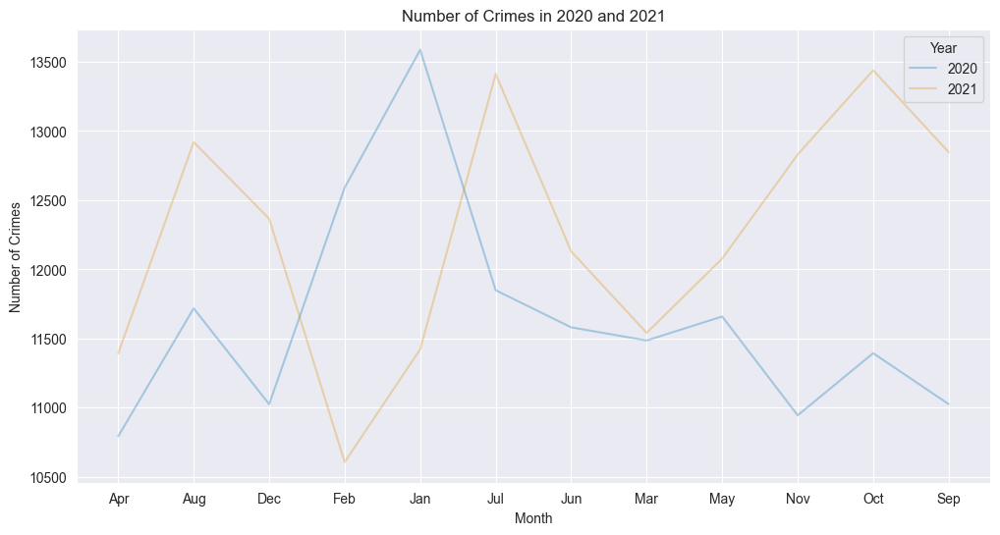

In [24]:
# Set the figure size for better visualization
plt.figure(figsize=(12, 6))

# Plot the area chart
sns.lineplot(data=merged_df, x='Month', y='Number of Crimes 2020', label='2020', alpha=0.3)
sns.lineplot(data=merged_df, x='Month', y='Number of Crimes 2021', label='2021', alpha=0.3)

# Add labels and title
plt.xlabel('Month')
plt.ylabel('Number of Crimes')
plt.title('Number of Crimes in 2020 and 2021')
plt.legend(title='Year')

# Display the plot
plt.show()

**Daily Trends**

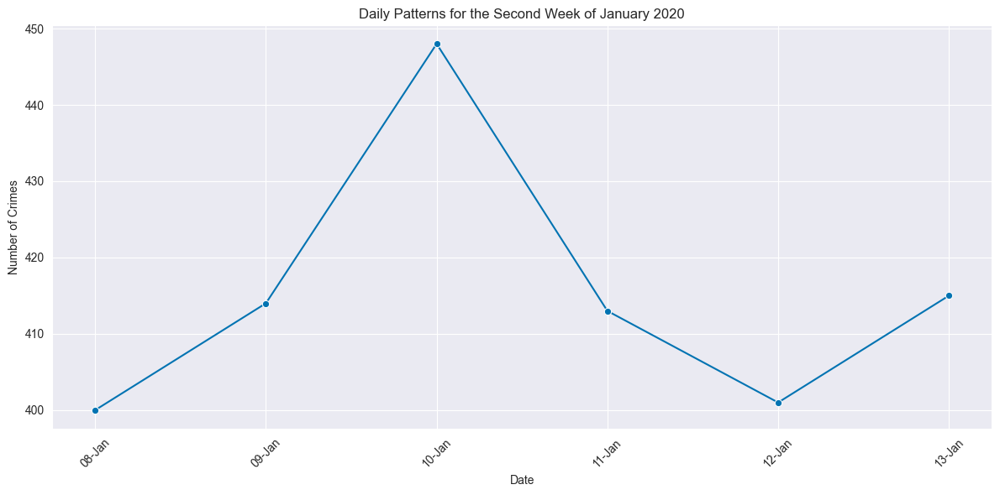

In [45]:
# Filter data for January 2020
start_date = '2020-01-08'
end_date = '2020-01-14'
df_january = df_sorted[(df_sorted.index >= start_date) & (df_sorted.index <= end_date)]

# Group by day and count occurrences
daily_counts_january = df_january.groupby(pd.Grouper(freq='D')).size()

# Reset index to access day as a column
daily_counts_january = daily_counts_january.reset_index()

# Rename columns
daily_counts_january.columns = ['Date', 'Number of Crimes']

# Plot the line chart using Seaborn
plt.figure(figsize=(12, 6)) 
sns.lineplot(data=daily_counts_january, x='Date', y='Number of Crimes', marker='o')

# Set titles, labels, and other plot properties
plt.title('Daily Patterns for the Second Week of January 2020')
plt.xlabel('Date')
plt.ylabel('Number of Crimes')
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
plt.grid(True)

# Format x-axis dates to show only day and month
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%d-%b'))

plt.tight_layout()  # Adjust layout to prevent clipping of labels
plt.show()


**Hourly Patterns**

C:\Users\neere\AppData\Local\Temp\ipykernel_5848\154492010.py:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



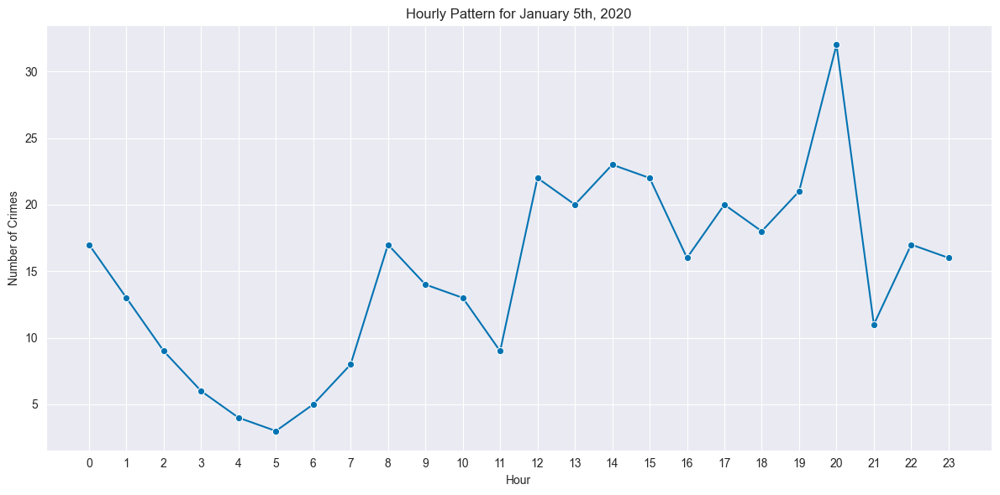

In [54]:
# Filter data for a specific day in January 2020
target_date = '2020-01-05'
end_date  = '2020-01-06'
df_specific_day = df_sorted[(df_sorted.index >= target_date) & (df_sorted.index < end_date)]

# Extract hour from 'TIME OCC' column
df_specific_day['Hour'] = df_specific_day.index.hour

# Group by hour and count occurrences
hourly_counts_specific_day = df_specific_day.groupby('Hour').size()

# Reset index to access hour as a column
hourly_counts_specific_day = hourly_counts_specific_day.reset_index()

# Rename columns
hourly_counts_specific_day.columns = ['Hour', 'Number of Crimes']

# Plot the line chart using Seaborn
plt.figure(figsize=(12, 6)) 
sns.lineplot(data=hourly_counts_specific_day, x='Hour', y='Number of Crimes', marker='o')

# Set titles, labels, and other plot properties
plt.title('Hourly Pattern for January 5th, 2020')
plt.xlabel('Hour')
plt.ylabel('Number of Crimes')
plt.xticks(range(24))  # Set ticks for all 24 hours
plt.grid(True)

plt.tight_layout()  # Adjust layout to prevent clipping of labels
plt.show()


### Simple variable analysis

**Weapon Analysis** (Bar chart)

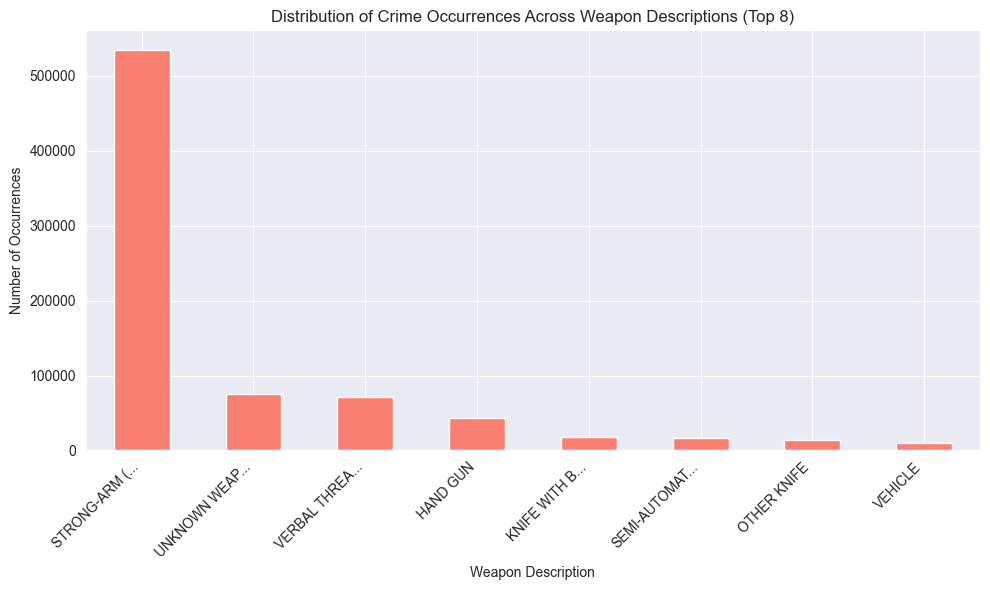

In [27]:
# Group by "Weapon Desc" and aggregate the count
N = 8
weapon_counts = df_sorted.groupby('Weapon Desc').size().nlargest(N)

# Truncate long weapon names
max_length = 12
weapon_counts.index = [weapon[:max_length] + '...' if len(weapon) > max_length else weapon for weapon in weapon_counts.index]

# Plotting
plt.figure(figsize=(10, 6))
weapon_counts.plot(kind='bar', color='salmon')
plt.title(f'Distribution of Crime Occurrences Across Weapon Descriptions (Top {N})')
plt.xlabel('Weapon Description')
plt.ylabel('Number of Occurrences')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()


**Weapon Analysis** (Polar chart + bars)

In [28]:
weapon_bar_polar_df = pd.DataFrame({'Weapon Desc': weapon_counts.index, 'Frequency': weapon_counts.values})

# Creating the polar bar chart
weapon_bar_polar = px.bar_polar(weapon_bar_polar_df, r="Frequency", theta="Weapon Desc",
                   template="plotly_dark", color_discrete_sequence=px.colors.sequential.Plasma_r)
weapon_bar_polar.show()


**Crime type Analysis** (Polar chart + bars)

In [29]:
N = 10
sig_crime_counts = df_sorted.groupby('Crm Cd Desc').size().nlargest(N)

# Truncate long Crime names
max_length = 20
sig_crime_counts.index = [crime[:max_length] + '...' if len(crime) > max_length else crime for crime in sig_crime_counts.index]

# Creating a DataFrame for Plotly Express
sig_crimes_df = pd.DataFrame({'Crime Description': sig_crime_counts.index, 'Frequency': sig_crime_counts.values})

# Creating the pie chart
custom_colors = px.colors.qualitative.Vivid

# Creating a dictionary to map category values to colors
color_map = {category: custom_colors[i % len(custom_colors)] for i, category in enumerate(sig_crimes_df['Crime Description'])}

# Creating the polar bar chart with custom colors and lower opacity
sig_crimes_bar_polar = px.bar_polar(sig_crimes_df, r="Frequency", theta="Crime Description",
                   template="plotly_dark", color="Crime Description",
                   color_discrete_map=color_map
                   )
sig_crimes_bar_polar.update_traces(opacity=0.6) 
sig_crimes_bar_polar.show()

**Crime type Analysis** (Bar chart)

In [30]:
N = 12
crime_cd_counts = df_sorted.groupby('Crm Cd Desc').size().nlargest(N)

# Truncate long Crime names
crime_cd_counts.index = [crime[:20] + '...' if len(crime) > 20 else crime for crime in crime_cd_counts.index]

# Creating a DataFrame for Plotly Express
sig_crimes_df = pd.DataFrame({'Crime Description': crime_cd_counts.index, 'Frequency': crime_cd_counts.values})

# Creating a custom color map
custom_colors = px.colors.qualitative.Vivid

# Creating a dictionary to map category values to colors
color_map = {category: custom_colors[i % len(custom_colors)] for i, category in enumerate(sig_crimes_df['Crime Description'])}

# Creating the bar chart with custom colors and lower opacity
sig_crimes_bar = px.bar(sig_crimes_df, x='Crime Description', y='Frequency',
             template="plotly_dark", color='Crime Description',
             color_discrete_map=color_map)
sig_crimes_bar.update_traces(opacity=0.6)  # Adjust the opacity as needed
sig_crimes_bar.show()


**Age distribution**

In [31]:
# Creating the histogram
age_hist = px.histogram(df_sorted, x='Vict Age', template="plotly_dark",
                   title='Distribution of Victim Ages (excluding zeros)')
age_hist.show()


In [32]:

df_filtered = df_sorted.dropna(subset=['Vict Descent'])
descent_counts = df_filtered.groupby('Vict Descent').size().nlargest(10)

# Truncate long Crime names
descent_counts.index = [descent[:20] + '...' if len(descent) > 20 else descent for descent in descent_counts.index]


# Creating a DataFrame for Plotly Express
df_plotly = pd.DataFrame({'Vict Descent': descent_counts.index, 'Frequency': descent_counts.values})

# Creating a custom color map
custom_colors = px.colors.qualitative.Vivid

# Creating a dictionary to map category values to colors
color_map = {category: custom_colors[i % len(custom_colors)] for i, category in enumerate(df_plotly['Vict Descent'])}

# Creating the bar chart with custom colors and lower opacity
fig = px.bar(df_plotly, x='Vict Descent', y='Frequency',
             template="plotly_dark", color='Vict Descent',
             color_discrete_map=color_map)
fig.update_traces(opacity=0.6)  # Adjust the opacity as needed
fig.show()


In [33]:

# Calculate value counts for each descent category
filtered_df = df_sorted.dropna(subset = ['Vict Sex'])
sex_counts = filtered_df['Vict Sex'].value_counts()

# Create Pie trace
fig = go.Figure(data=[go.Pie(labels=sex_counts.index, values=sex_counts.values)])

# Update layout
fig.update_layout(title='Victim Sex Distribution')

# Show the plot
fig.show()


### Multi-variable analysis

**Correlation Crime type & District**

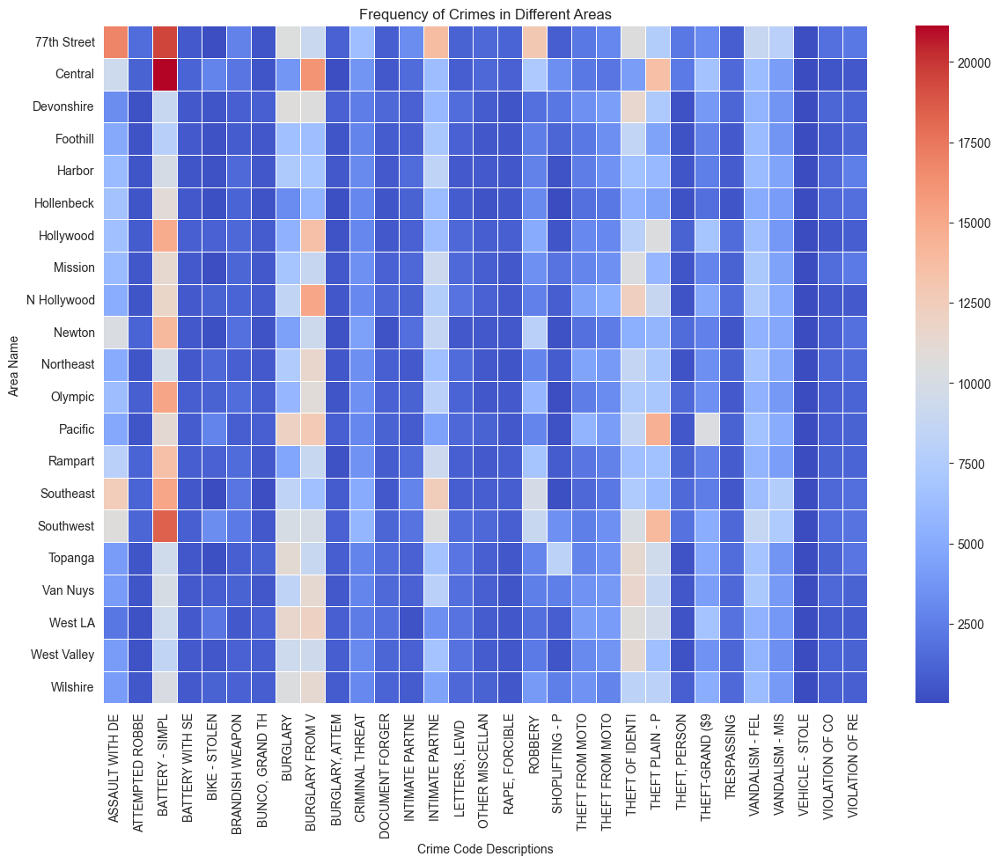

In [34]:
# Pivot the DataFrame to get counts of each crime in each area
pivot_df = df_sorted.pivot_table(index='AREA NAME', columns='Crm Cd Desc', aggfunc='size', fill_value=0)

# Truncate the length of crime code descriptions for readability
max_length = 15
pivot_df.columns = [col[:max_length] for col in pivot_df.columns]

# Create the heatmap
plt.figure(figsize=(14, 10))
sns.heatmap(pivot_df, cmap='coolwarm', linewidths=.5)
plt.title('Frequency of Crimes in Different Areas')
plt.xlabel('Crime Code Descriptions')
plt.ylabel('Area Name')
plt.show()


**Correlation Crime type & Gender of victim**

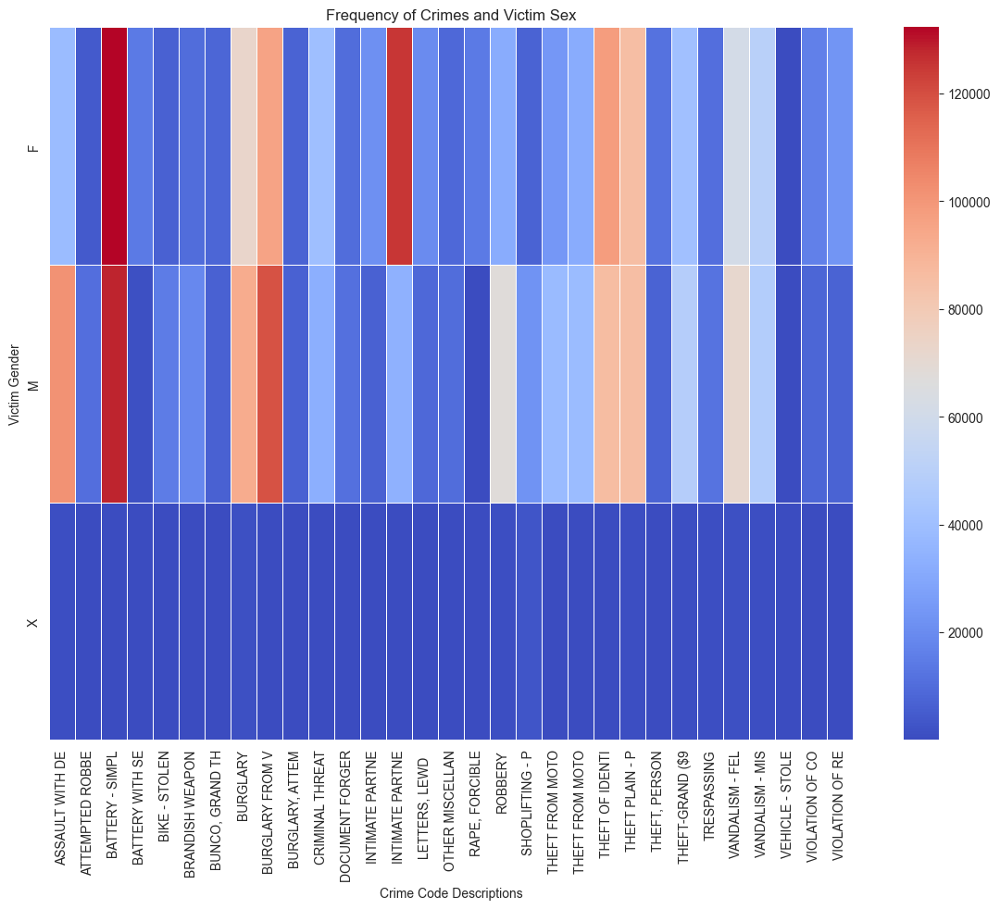

In [35]:
# Pivot the DataFrame to get counts of each crime in each area
pivot_df = df_sorted.pivot_table(index='Vict Sex', columns='Crm Cd Desc', aggfunc='size', fill_value=0)

# Truncate the length of crime code descriptions for readability
max_length = 15 
pivot_df.columns = [col[:max_length] for col in pivot_df.columns]

# Create the heatmap
plt.figure(figsize=(14, 10))
sns.heatmap(pivot_df, cmap='coolwarm', linewidths=.5)
plt.title('Frequency of Crimes and Victim Sex')
plt.xlabel('Crime Code Descriptions')
plt.ylabel('Victim Gender')
plt.show()


**Correlation Crime type & Descent of victim**

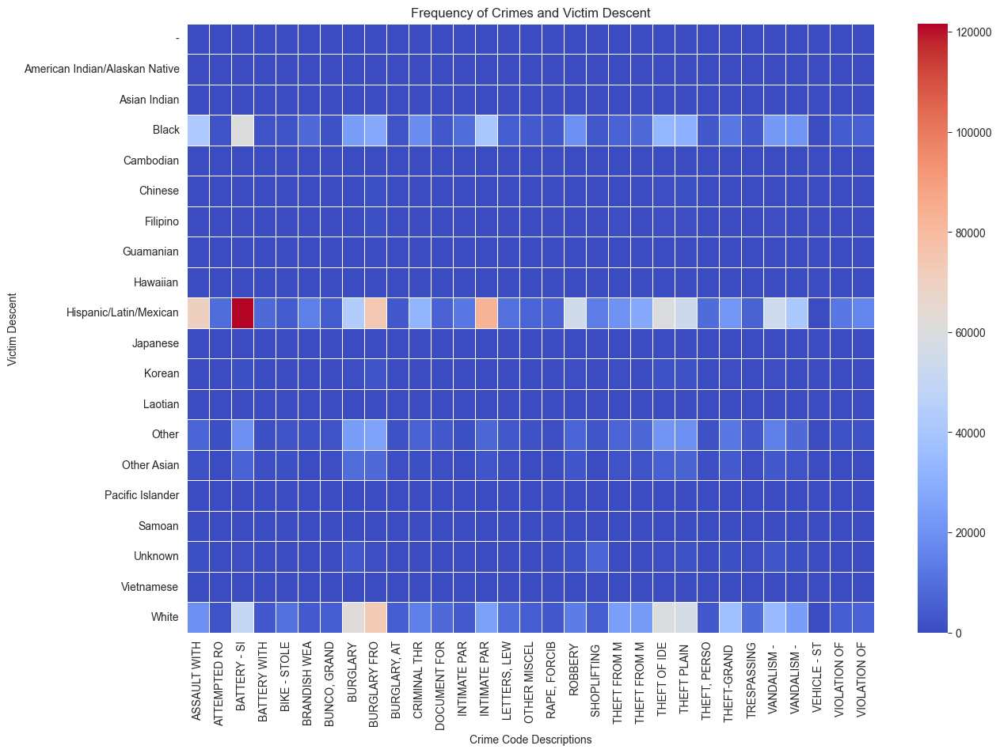

In [36]:
# Multi-variable correlation Victim Descent and Crime
# Pivot the DataFrame to get counts of each crime in each area
pivot_df = df_sorted.pivot_table(index='Vict Descent', columns='Crm Cd Desc', aggfunc='size', fill_value=0)

# Truncate the length of crime code descriptions for readability
max_length = 12
pivot_df.columns = [col[:max_length] for col in pivot_df.columns]

# Create the heatmap
plt.figure(figsize=(14, 10))
sns.heatmap(pivot_df, cmap='coolwarm', linewidths=.5)
plt.title('Frequency of Crimes and Victim Descent')
plt.xlabel('Crime Code Descriptions')
plt.ylabel('Victim Descent')
plt.show()

### GEOJSON

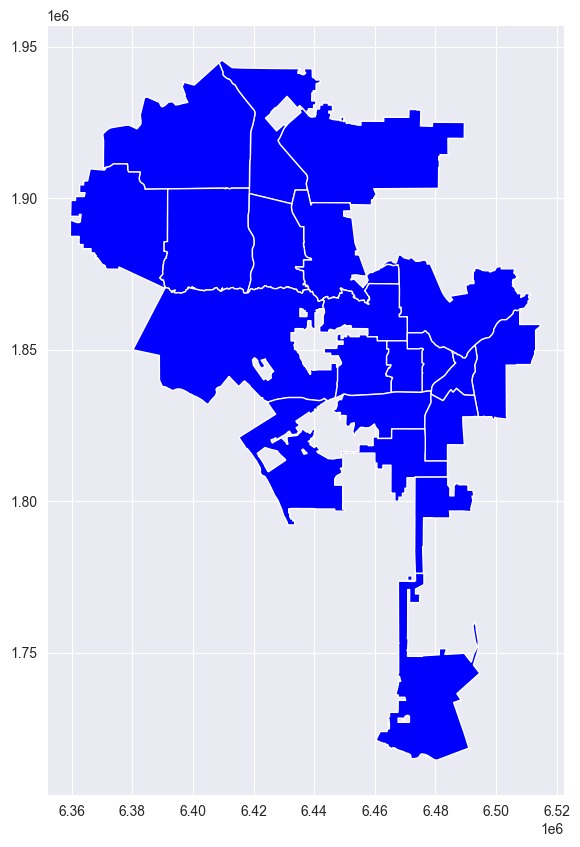

In [37]:
# Load the GeoJSON file
gdf = gpd.read_file(geojson_path)
# Replace "North Hollywood" with "N Hollywood"
gdf.loc[gdf['APREC'] == "NORTH HOLLYWOOD", 'APREC'] = "N Hollywood"

# Replace "West Los Angeles" with "West LA"
gdf.loc[gdf['APREC'] == "WEST LOS ANGELES", 'APREC'] = "West LA"
# Plot all districts with the same color
fig, ax = plt.subplots(figsize=(10, 10))
gdf.plot(ax=ax, color='blue')  # Change 'blue' to any color you prefer
plt.show()

In [38]:
# Group by year and "AREA NAME", then count the number of crimes
df_copy = df_sorted
df_copy['Year'] = df_sorted.index.year
crime_counts = df_copy.groupby(['Year', 'AREA NAME']).size().reset_index(name='Crime Count')
crime_counts = crime_counts.rename(columns={'AREA NAME': 'APREC'})

# Standardize 'APREC' values
crime_counts['APREC'] = crime_counts['APREC'].str.lower().str.strip()
gdf['APREC'] = gdf['APREC'].str.lower().str.strip()

In [39]:
# Merge GeoDataFrame with crime counts DataFrame on 'APREC' column
merged_gdf = gdf.merge(crime_counts.pivot(index='APREC', columns='Year', values='Crime Count'),
                       how='left', on='APREC')

merged_gdf.head(1)

,OBJECTID,APREC,PREC,AREA,PERIMETER,geometry,2010,2011,2012,2013,...,2015,2016,2017,2018,2019,2020,2021,2022,2023,2024
0,1,mission,19,6.995826e+08,190817.495739,"POLYGON ((6408504.431 1944548.806, 6409580.000...",7679,7776,7883,7596,...,7750,8391,8391,7590,6877,5970,5906,6641,5957,1471


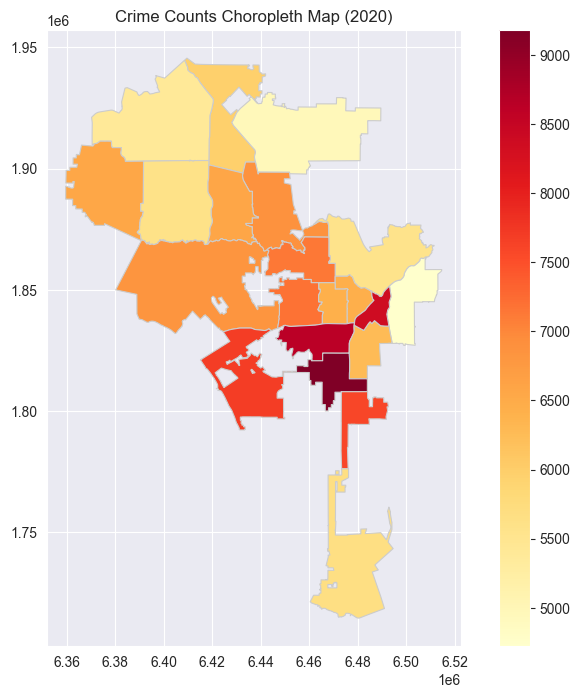

In [40]:
# Filter the merged GeoDataFrame for 2020
merged_gdf_2020 = merged_gdf[['geometry', 2020]].copy()

# Plot the choropleth map
fig, ax = plt.subplots(1, 1, figsize=(10, 8))
merged_gdf_2020.plot(column=2020, cmap='YlOrRd', linewidth=0.8, ax=ax, edgecolor='0.8', legend=True)
ax.set_title('Crime Counts Choropleth Map (2020)')
plt.show()

<Axes: >

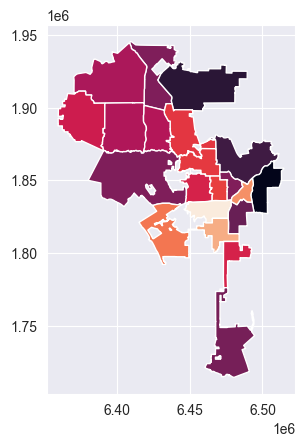

In [41]:
merged_gdf.plot(column=2024)

In [ ]:
import plotly.express as px
import geopandas as gpd

# Convert GeoDataFrame to EPSG:4326 CRS
merged_gdf = merged_gdf.to_crs("EPSG:4326")

# Plot the choropleth map for the year 2010 with a continuous color scale
fig = px.choropleth_mapbox(merged_gdf, 
                            geojson=merged_gdf.geometry.__geo_interface__,  # Convert geometry to GeoJSON
                            locations=merged_gdf.index, 
                            color=2010,  # Specify the column containing the values to color
                            color_continuous_scale="Blues",  # Use a continuous blue color scale
                            range_color=(merged_gdf[2010].min(), merged_gdf[2010].max()),  # Set the range of the color scale
                            mapbox_style="carto-positron",  # Mapbox base style
                            zoom=9,  # Adjust zoom level
                            center={"lat": 34.0522, "lon": -118.2437},  # Centered around Los Angeles
                            opacity=0.7,
                            labels={'2010':'Crime Count'}
                           )

fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})  # Adjust layout margin
fig.show()


In [44]:
# Filter sorted crime data based on the bounds of the map view
filtered_crime_data = df_sorted[df_sorted.index.year == 2020]

# Convert GeoDataFrame to EPSG:4326 CRS
merged_gdf = merged_gdf.to_crs("EPSG:4326")

# Plot the choropleth map for the year 2011 with a continuous color scale
fig = px.choropleth_mapbox(merged_gdf, 
                            geojson=merged_gdf.geometry.__geo_interface__,  # Convert geometry to GeoJSON
                            locations=merged_gdf.index, 
                            color=2011,  # Specify the column containing the values to color
                            color_continuous_scale="Blues",  # Use a continuous blue color scale
                            range_color=(merged_gdf[2011].min(), merged_gdf[2011].max()),  # Set the range of the color scale
                            mapbox_style="carto-positron",  # Mapbox base style
                            zoom=9,  # Adjust zoom level
                            center={"lat": 34.0522, "lon": -118.2437},  # Centered around Los Angeles
                            opacity=0.7,
                            labels={'2011':'Crime Count'}
                           )

# Add scatter plot overlay for filtered crime data
fig.add_scattermapbox(
    lat=filtered_crime_data['LAT'],
    lon=filtered_crime_data['LON'],
    mode='markers',
    marker=dict(
        size=5,
        color='red',
        opacity=0.5
    ),
    hoverinfo='text'
)

fig.update_layout(
    margin={"r":0,"t":0,"l":0,"b":0},  # Adjust layout margin
    mapbox={'center': {'lon': -118.2437, 'lat': 34.0522}},
    hovermode='closest'
)

fig.show()
